In [1]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt

form_dir = 'form_200507'

def percent_string(p):
    return f'{int(np.round(p*100))}%'

In [2]:
# Parse CSV with answers
with open(os.path.join(form_dir, 'form.csv'), 'r') as f:
    answers = f.read().splitlines()
answers = [list(eval(answer))[1:] for answer in answers[1:]]
answers = np.array([[0 if a == 'a' else 1 for a in answer] for answer in answers])

# Adjust ordering
order = np.load(os.path.join(form_dir, 'order.npy'))
answers = (answers + order) % 2

# Calculate mean answers for each question
mean = answers.mean(axis=0)

# Load image paths
with open(os.path.join(form_dir, 'images.pkl'), 'rb') as f:
    images = pickle.load(f)
images = [os.path.split(image)[1] for image in images]

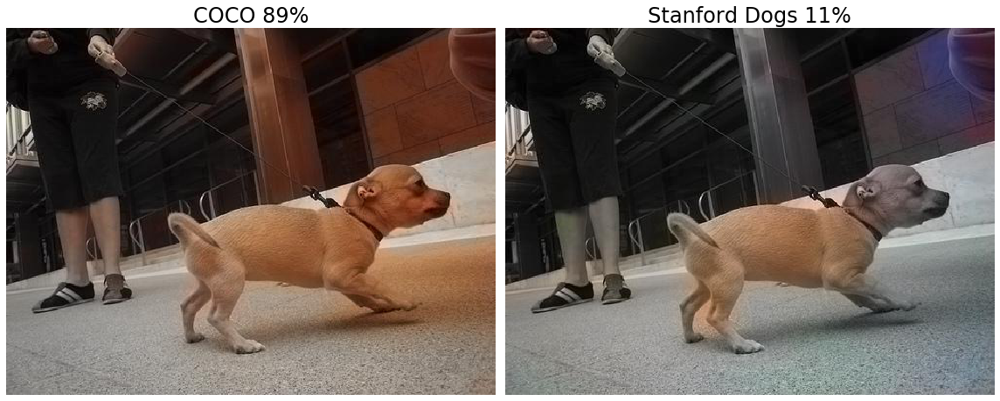

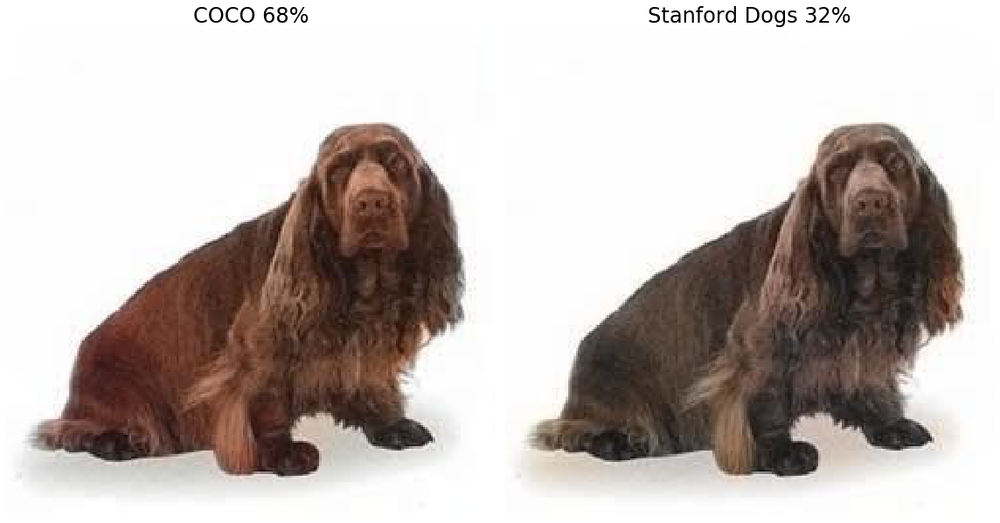

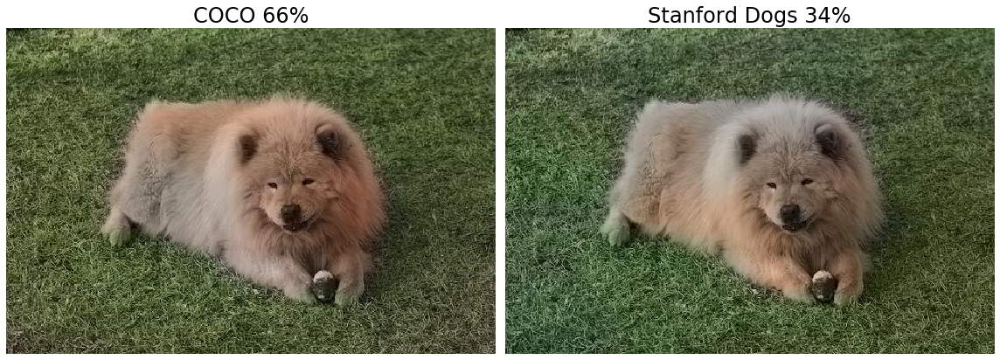

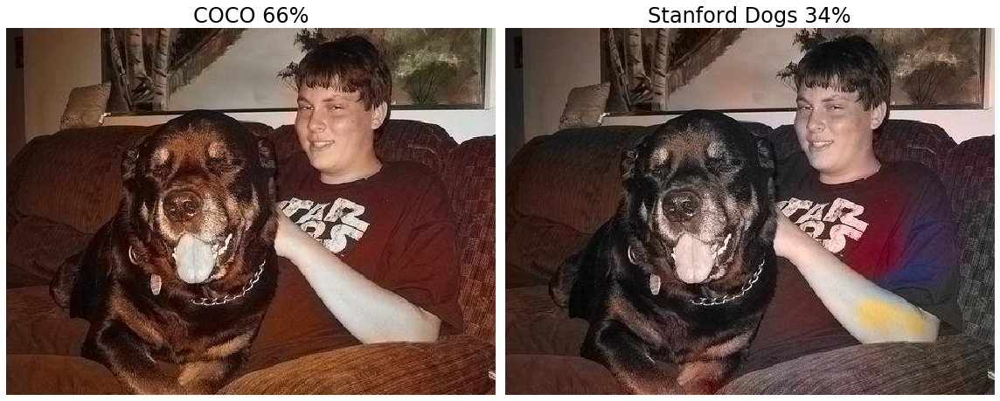

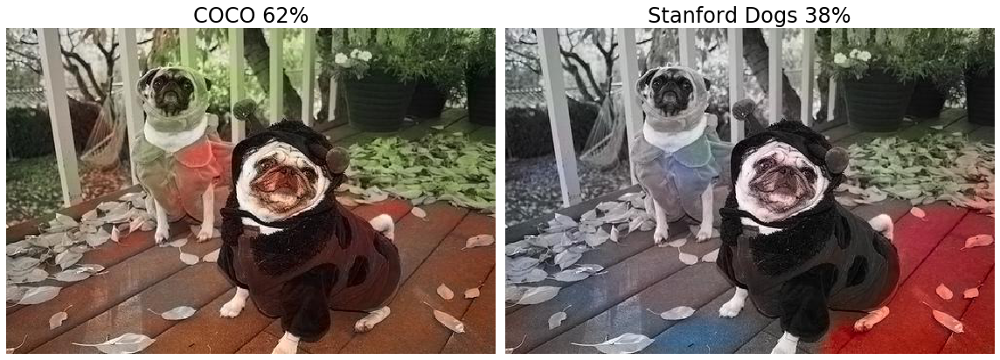

...

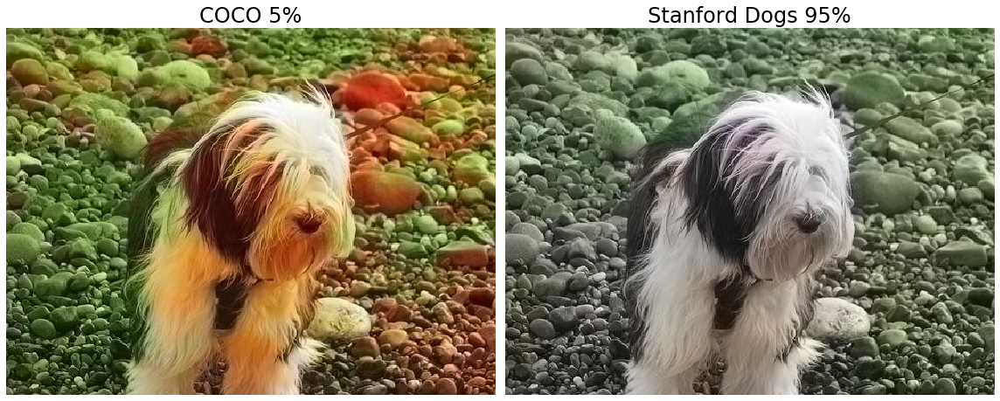

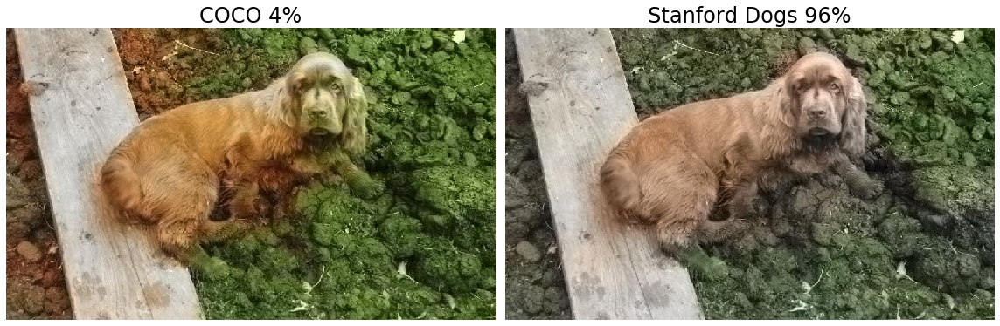

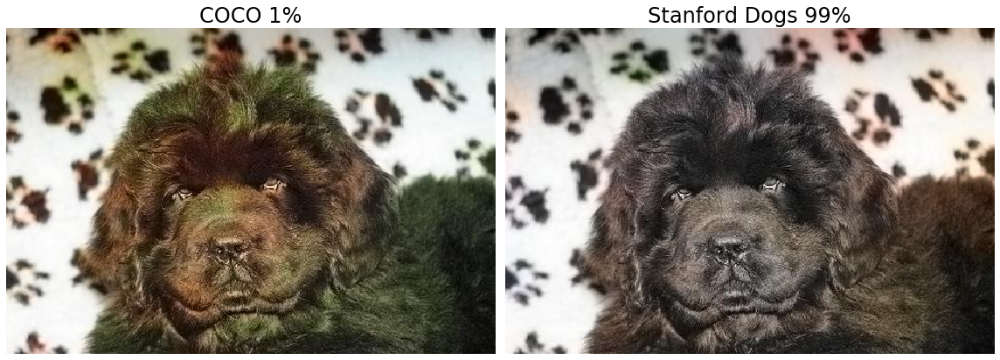

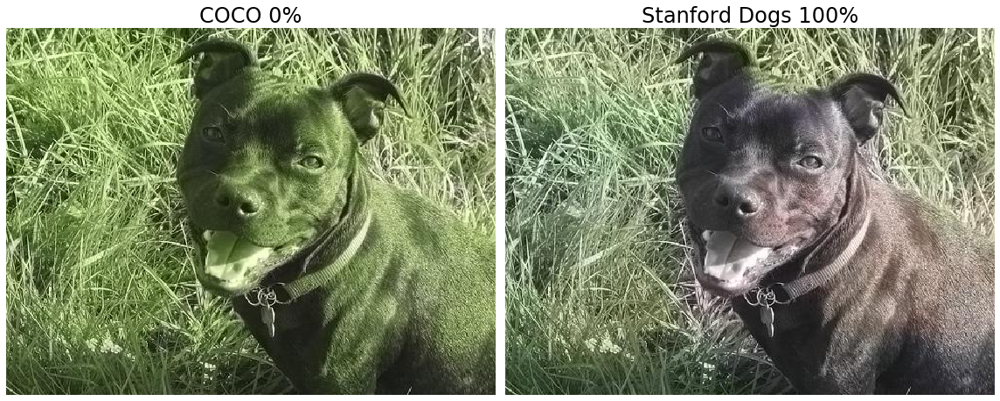

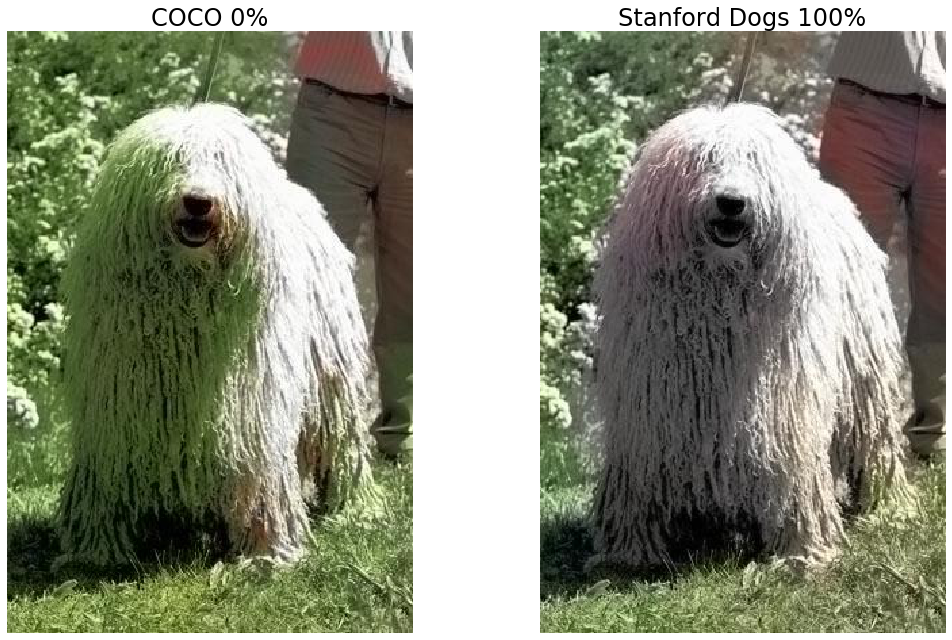

In [3]:
# Show the images and their percent
models = ['coco', 'dogs']
def show_pair(image, percent):
    fig = plt.figure(figsize=(16, 9))
    for i, model in enumerate(models, start=1):
        ax = fig.add_subplot(1, len(models), i)
        plt.imshow(plt.imread(os.path.join(form_dir, model, image)))
        p = percent if model == 'dogs' else 1 - percent
        title = 'Stanford Dogs' if model == 'dogs' else 'COCO'
        ax.set_title(f'{title} {percent_string(p)}', fontsize=24)
        plt.axis('off')
    fig.tight_layout()
    plt.show()

sorted_by_mean = sorted(np.arange(len(mean)), key=lambda x: mean[x])
for i in sorted_by_mean:
    show_pair(images[i], mean[i])

People prefered the Stanford Dogs model in 21/30 of the images
68% of the total votes went toward the Stanford Dogs model


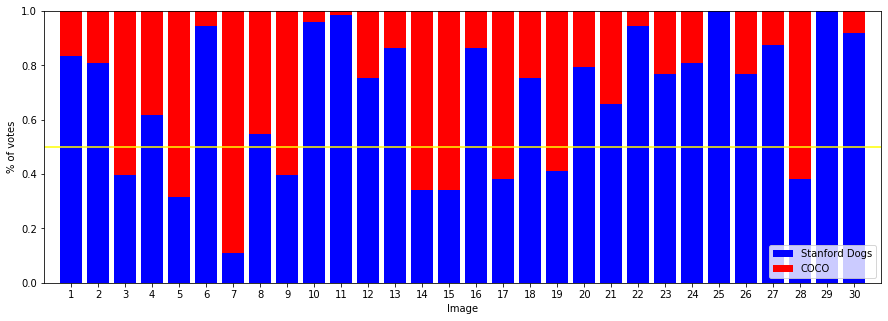

In [9]:
print(f'People prefered the Stanford Dogs model in {(mean > 0.5).sum()}/30 of the images')
print(f'{percent_string(mean.mean())} of the total votes went toward the Stanford Dogs model')

plt.figure(figsize=(15, 5))
plt.bar(np.arange(1, 31), mean, color='blue', label='Stanford Dogs')
plt.bar(np.arange(1, 31), (1 - mean), bottom=mean, color='red', label='COCO')
plt.hlines(0.5, 0, 31, color='yellow')
plt.xlim(0, 31)
plt.xlabel('Image')
plt.ylabel('% of votes')
plt.xticks([i for i in range(1, 31)])
plt.legend(loc='lower right')